## Import Statements

In [2]:
import numpy as np
import pandas as pd 
import seaborn as sns
import datetime as dt
from datetime import datetime
from matplotlib import pyplot as plt
import plotly.express as px
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
import random

## About the Dataset

Date time year-month-day hour:minute:second

1.   Appliances, energy use in Wh

2.   Lights, energy use of light fixtures in the house in Wh

3.   T1, Temperature in kitchen area, in Celsius

4.   RH1,Humidity in kitchen area, in % 

5.   T2, Temperature in living room area,in Celsius 

6.   RH2,Humidity in living room area, in % 

7.   T3  Temperature in laundry room area

8.   RH3,Humidity in laundry room area, in % 

9.   T4, Temperature in office room, in Celsius 

10.  RH4,Humidity in office room, in % 

11.  T5, Temperature in bathroom, in Celsius

12.  RH5, Humidity in bathroom, in % 

13.  T6, Temperature outside the building (north side), in Celsius 

14.  RH6,Humidity outside the building (north side), in % 

15.  T7, Temperature in ironing room , in Celsius 

16.  RH7,Humidity in ironing room, in % 

17.  T8, Temperature in teenager room 2, in Celsius 

18.  RH8,Humidity in teenager room 2, in % 

19.  T9, Temperature in parents room, in Celsius 

20.  RH9,Humidity in parents room, in % 

21.  To, Temperature outside (from Chievres weather station), in Celsius 

22. Pressure (from Chievres weather station), in mm Hg RHout, 

23. Humidity outside (from Chievres weather station), in % 

24. Wind speed (from Chievres weather station), in m/s 

25. Visibility (from Chievres weather station), in km 

26. Tdewpoint (from Chievres weather station), Â°C 

27. rv1, Random variable 1, nondimensional

28. rv2, Random variable 2, nondimensional


Where indicated, hourly data (then interpolated) from the nearest airport weather station (Chievres Airport, Belgium) was downloaded from a public data set from Reliable Prognosis, rp5.ru. Permission was obtained from Reliable Prognosis for the distribution of the 4.5 months of weather data.

## Loading the Dataset


In [3]:
energy = pd.read_csv("KAG_energydata_complete.csv")
energy.head()

,date,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,...,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2
0,2016-01-11 17:00:00,60,30,19.89,47.596667,19.2,44.790000,19.79,44.730000,19.000000,...,17.033333,45.53,6.600000,733.5,92.0,7.000000,63.000000,5.3,13.275433,13.275433
1,2016-01-11 17:10:00,60,30,19.89,46.693333,19.2,44.722500,19.79,44.790000,19.000000,...,17.066667,45.56,6.483333,733.6,92.0,6.666667,59.166667,5.2,18.606195,18.606195
2,2016-01-11 17:20:00,50,30,19.89,46.300000,19.2,44.626667,19.79,44.933333,18.926667,...,17.000000,45.50,6.366667,733.7,92.0,6.333333,55.333333,5.1,28.642668,28.642668
3,2016-01-11 17:30:00,50,40,19.89,46.066667,19.2,44.590000,19.79,45.000000,18.890000,...,17.000000,45.40,6.250000,733.8,92.0,6.000000,51.500000,5.0,45.410389,45.410389
4,2016-01-11 17:40:00,60,40,19.89,46.333333,19.2,44.530000,19.79,45.000000,18.890000,...,17.000000,45.40,6.133333,733.9,92.0,5.666667,47.666667,4.9,10.084097,10.084097


In [3]:
energy.tail()

,date,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,...,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2
19730,2016-05-27 17:20:00,100,0,25.566667,46.560000,25.890000,42.025714,27.200000,41.163333,24.7,...,23.2,46.7900,22.733333,755.2,55.666667,3.333333,23.666667,13.333333,43.096812,43.096812
19731,2016-05-27 17:30:00,90,0,25.500000,46.500000,25.754000,42.080000,27.133333,41.223333,24.7,...,23.2,46.7900,22.600000,755.2,56.000000,3.500000,24.500000,13.300000,49.282940,49.282940
19732,2016-05-27 17:40:00,270,10,25.500000,46.596667,25.628571,42.768571,27.050000,41.690000,24.7,...,23.2,46.7900,22.466667,755.2,56.333333,3.666667,25.333333,13.266667,29.199117,29.199117
19733,2016-05-27 17:50:00,420,10,25.500000,46.990000,25.414000,43.036000,26.890000,41.290000,24.7,...,23.2,46.8175,22.333333,755.2,56.666667,3.833333,26.166667,13.233333,6.322784,6.322784
19734,2016-05-27 18:00:00,430,10,25.500000,46.600000,25.264286,42.971429,26.823333,41.156667,24.7,...,23.2,46.8450,22.200000,755.2,57.000000,4.000000,27.000000,13.200000,34.118851,34.118851


## Data Exploration

In [4]:
energy.shape

(19735, 29)

In [5]:
energy.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19735 entries, 0 to 19734
Data columns (total 29 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   date         19735 non-null  object 
 1   Appliances   19735 non-null  int64  
 2   lights       19735 non-null  int64  
 3   T1           19735 non-null  float64
 4   RH_1         19735 non-null  float64
 5   T2           19735 non-null  float64
 6   RH_2         19735 non-null  float64
 7   T3           19735 non-null  float64
 8   RH_3         19735 non-null  float64
 9   T4           19735 non-null  float64
 10  RH_4         19735 non-null  float64
 11  T5           19735 non-null  float64
 12  RH_5         19735 non-null  float64
 13  T6           19735 non-null  float64
 14  RH_6         19735 non-null  float64
 15  T7           19735 non-null  float64
 16  RH_7         19735 non-null  float64
 17  T8           19735 non-null  float64
 18  RH_8         19735 non-null  float64
 19  T9  

In [6]:
energy.isnull().sum()

date           0
Appliances     0
lights         0
T1             0
RH_1           0
T2             0
RH_2           0
T3             0
RH_3           0
T4             0
RH_4           0
T5             0
RH_5           0
T6             0
RH_6           0
T7             0
RH_7           0
T8             0
RH_8           0
T9             0
RH_9           0
T_out          0
Press_mm_hg    0
RH_out         0
Windspeed      0
Visibility     0
Tdewpoint      0
rv1            0
rv2            0
dtype: int64

In [7]:
energy.describe()

,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,...,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2
count,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,...,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000
mean,97.694958,3.801875,21.686571,40.259739,20.341219,40.420420,22.267611,39.242500,20.855335,39.026904,...,19.485828,41.552401,7.411665,755.522602,79.750418,4.039752,38.330834,3.760707,24.988033,24.988033
std,102.524891,7.935988,1.606066,3.979299,2.192974,4.069813,2.006111,3.254576,2.042884,4.341321,...,2.014712,4.151497,5.317409,7.399441,14.901088,2.451221,11.794719,4.194648,14.496634,14.496634
min,10.000000,0.000000,16.790000,27.023333,16.100000,20.463333,17.200000,28.766667,15.100000,27.660000,...,14.890000,29.166667,-5.000000,729.300000,24.000000,0.000000,1.000000,-6.600000,0.005322,0.005322
25%,50.000000,0.000000,20.760000,37.333333,18.790000,37.900000,20.790000,36.900000,19.530000,35.530000,...,18.000000,38.500000,3.666667,750.933333,70.333333,2.000000,29.000000,0.900000,12.497889,12.497889
50%,60.000000,0.000000,21.600000,39.656667,20.000000,40.500000,22.100000,38.530000,20.666667,38.400000,...,19.390000,40.900000,6.916667,756.100000,83.666667,3.666667,40.000000,3.433333,24.897653,24.897653
75%,100.000000,0.000000,22.600000,43.066667,21.500000,43.260000,23.290000,41.760000,22.100000,42.156667,...,20.600000,44.338095,10.408333,760.933333,91.666667,5.500000,40.000000,6.566667,37.583769,37.583769
max,1080.000000,70.000000,26.260000,63.360000,29.856667,56.026667,29.236000,50.163333,26.200000,51.090000,...,24.500000,53.326667,26.100000,772.300000,100.000000,14.000000,66.000000,15.500000,49.996530,49.996530


In [8]:
#converting date into datetime
energy['date'] = energy['date'].astype('datetime64[ns]')
energy.head()

,date,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,...,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2
0,2016-01-11 17:00:00,60,30,19.89,47.596667,19.2,44.790000,19.79,44.730000,19.000000,...,17.033333,45.53,6.600000,733.5,92.0,7.000000,63.000000,5.3,13.275433,13.275433
1,2016-01-11 17:10:00,60,30,19.89,46.693333,19.2,44.722500,19.79,44.790000,19.000000,...,17.066667,45.56,6.483333,733.6,92.0,6.666667,59.166667,5.2,18.606195,18.606195
2,2016-01-11 17:20:00,50,30,19.89,46.300000,19.2,44.626667,19.79,44.933333,18.926667,...,17.000000,45.50,6.366667,733.7,92.0,6.333333,55.333333,5.1,28.642668,28.642668
3,2016-01-11 17:30:00,50,40,19.89,46.066667,19.2,44.590000,19.79,45.000000,18.890000,...,17.000000,45.40,6.250000,733.8,92.0,6.000000,51.500000,5.0,45.410389,45.410389
4,2016-01-11 17:40:00,60,40,19.89,46.333333,19.2,44.530000,19.79,45.000000,18.890000,...,17.000000,45.40,6.133333,733.9,92.0,5.666667,47.666667,4.9,10.084097,10.084097


In [9]:
#making the date, tiem, hour and month into a diff column and thus converting them into date time format
energy['Date'] = pd.to_datetime(energy['date']).dt.date
energy['Time'] = pd.to_datetime(energy['date']).dt.time
energy['hour'] = energy['date'].dt.hour
energy['month'] = energy['date'].dt.month

## Data Preprocessing

In [10]:
#scaling the data
scaler = MinMaxScaler(feature_range=(0,10))
energy[['Appliances','lights','T1','RH_1','T2','RH_2','T3','RH_3','T4','RH_4','T5','RH_5','T6','RH_6','T7','RH_7','T8','RH_8','T9','RH_9','T_out','Press_mm_hg','RH_out','Windspeed','Visibility','Tdewpoint','rv1','rv2']] = scaler.fit_transform(energy[['Appliances','lights','T1','RH_1','T2','RH_2','T3','RH_3','T4','RH_4','T5','RH_5','T6','RH_6','T7','RH_7','T8','RH_8','T9','RH_9','T_out','Press_mm_hg','RH_out','Windspeed','Visibility','Tdewpoint','rv1','rv2']])
energy_transformed = energy
energy_transformed

,date,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,...,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2,Date,Time,hour,month
0,2016-01-11 17:00:00,0.467290,4.285714,3.273495,5.661866,2.253453,6.840379,2.151878,7.460664,3.513514,...,8.947368,5.000000,9.538462,5.384615,2.654489,2.654489,2016-01-11,17:00:00,17,1
1,2016-01-11 17:10:00,0.467290,4.285714,3.273495,5.413265,2.253453,6.821398,2.151878,7.488705,3.513514,...,8.947368,4.761905,8.948718,5.339367,3.720829,3.720829,2016-01-11,17:10:00,17,1
2,2016-01-11 17:20:00,0.373832,4.285714,3.273495,5.305018,2.253453,6.794451,2.151878,7.555694,3.447447,...,8.947368,4.523810,8.358974,5.294118,5.728477,5.728477,2016-01-11,17:20:00,17,1
3,2016-01-11 17:30:00,0.373832,5.714286,3.273495,5.240804,2.253453,6.784141,2.151878,7.586852,3.414414,...,8.947368,4.285714,7.769231,5.248869,9.082611,9.082611,2016-01-11,17:30:00,17,1
4,2016-01-11 17:40:00,0.467290,5.714286,3.273495,5.314191,2.253453,6.767270,2.151878,7.586852,3.414414,...,8.947368,4.047619,7.179487,5.203620,2.016109,2.016109,2016-01-11,17:40:00,17,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19730,2016-05-27 17:20:00,0.841121,0.000000,9.267863,5.376571,7.116550,6.063093,8.308408,5.793737,8.648649,...,4.166667,2.380952,3.487179,9.019608,8.619814,8.619814,2016-05-27,17:20:00,17,5
19731,2016-05-27 17:30:00,0.747664,0.000000,9.197466,5.360059,7.017688,6.078358,8.253019,5.821779,8.648649,...,4.210526,2.500000,3.615385,9.004525,9.857257,9.857257,2016-05-27,17:30:00,17,5
19732,2016-05-27 17:40:00,2.429907,1.428571,9.197466,5.386662,6.926512,6.271976,8.183782,6.039882,8.648649,...,4.254386,2.619048,3.743590,8.989442,5.839786,5.839786,2016-05-27,17:40:00,17,5
19733,2016-05-27 17:50:00,3.831776,1.428571,9.197466,5.494909,6.770535,6.347174,8.050847,5.852937,8.648649,...,4.298246,2.738095,3.871795,8.974359,1.263715,1.263715,2016-05-27,17:50:00,17,5


In [11]:
#splitting into test and train
train, test = train_test_split(energy_transformed,test_size=0.30,random_state=25)

In [12]:
#train dataset
train

,date,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,...,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2,Date,Time,hour,month
2242,2016-01-27 06:40:00,0.280374,0.000000,3.389652,4.889460,2.391568,6.691349,2.077102,7.133510,3.513514,...,7.412281,7.142857,4.871795,6.138763,3.299717,3.299717,2016-01-27,06:40:00,6,1
16106,2016-05-02 13:20:00,0.560748,0.000000,5.807814,2.387854,5.815362,2.831568,4.514235,3.081477,6.756757,...,1.578947,2.142857,4.666667,3.242836,6.789524,6.789524,2016-05-02,13:20:00,13,5
6623,2016-02-26 16:50:00,0.373832,0.000000,4.023231,2.332814,2.253453,4.200019,3.065803,3.394610,4.144144,...,5.614035,2.023810,3.692308,2.760181,1.746643,1.746643,2016-02-26,16:50:00,16,2
13483,2016-04-14 08:10:00,0.560748,2.857143,4.857445,3.881295,1.793070,7.021277,4.644400,4.450849,6.336336,...,10.000000,0.714286,1.846154,4.155354,1.046540,1.046540,2016-04-14,08:10:00,8,4
13230,2016-04-12 14:00:00,0.373832,0.000000,6.135164,4.063847,5.689363,4.640547,5.034895,5.000779,7.534535,...,4.210526,2.857143,6.000000,5.701357,5.720707,5.720707,2016-04-12,14:00:00,14,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7324,2016-03-02 13:40:00,0.841121,0.000000,4.621612,2.908907,3.070027,4.215953,2.880248,4.611310,5.282282,...,5.526316,6.666667,6.000000,3.740573,4.867315,4.867315,2016-03-02,13:40:00,13,3
1160,2016-01-19 18:20:00,1.214953,1.428571,2.404083,3.320796,1.138842,5.426001,1.246261,4.622215,2.423423,...,7.982456,0.714286,5.179487,0.965309,0.842389,0.842389,2016-01-19,18:20:00,18,1
1175,2016-01-19 20:50:00,4.112150,1.428571,2.861668,3.671223,1.744609,5.623770,2.824859,6.215921,3.753754,...,9.100877,1.190476,9.256410,0.603318,0.743045,0.743045,2016-01-19,20:50:00,20,1
2934,2016-02-01 02:00:00,0.373832,2.857143,5.279831,5.497661,3.481948,7.377449,3.788634,8.287895,3.573574,...,8.947368,5.000000,3.538462,7.511312,8.291642,8.291642,2016-02-01,02:00:00,2,2


In [13]:
#train describe
train.describe()

,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,...,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2,hour,month
count,13814.000000,13814.000000,13814.000000,13814.000000,13814.000000,13814.000000,13814.000000,13814.000000,13814.000000,13814.000000,...,13814.000000,13814.000000,13814.000000,13814.000000,13814.000000,13814.000000,13814.000000,13814.000000,13814.000000,13814.000000
mean,0.815839,0.541066,5.169813,3.644761,3.082644,5.613576,4.204236,4.902368,5.177180,4.860423,...,3.980019,6.101685,7.354950,2.876276,5.731730,4.687883,4.970368,4.970368,11.467569,3.098740
std,0.957318,1.128552,1.692477,1.095865,1.596040,1.138723,1.658000,1.526130,1.842929,1.857423,...,1.705852,1.719616,1.947083,1.748717,1.814839,1.898148,2.897624,2.897624,6.937961,1.339046
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.007752,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
25%,0.373832,0.000000,4.160507,2.844693,1.955416,4.893678,2.982719,3.801215,3.963964,3.361929,...,2.781350,5.031008,6.118421,1.428571,4.307692,3.393665,2.468526,2.468526,5.000000,2.000000
50%,0.467290,0.000000,5.079197,3.470324,2.834989,5.634080,4.071120,4.577037,4.984985,4.583867,...,3.810289,6.232558,7.894737,2.619048,6.000000,4.532428,4.969025,4.969025,11.000000,3.000000
75%,0.841121,0.000000,6.135164,4.421613,3.925370,6.409926,5.059821,6.086618,6.306306,6.205719,...,4.946409,7.368217,8.903509,3.928571,6.000000,5.957768,7.455440,7.455440,17.000000,4.000000
max,8.130841,7.142857,10.000000,8.974406,10.000000,10.000000,9.970090,10.000000,10.000000,10.000000,...,10.000000,10.000000,10.000000,9.642857,10.000000,10.000000,9.999329,9.999329,23.000000,5.000000


In [14]:
#test dataset
test

,date,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,...,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2,Date,Time,hour,month
7624,2016-03-04 15:40:00,2.336449,0.000000,4.254035,2.971680,2.300183,4.729055,3.922756,4.828077,3.667954,...,6.842105,1.190476,5.384615,4.132730,1.993555,1.993555,2016-03-04,15:40:00,15,3
9021,2016-03-14 08:30:00,2.803738,0.000000,3.389652,2.156683,0.314999,5.163558,2.517448,3.548839,3.603604,...,8.355263,3.571429,9.384615,2.420814,4.685200,4.685200,2016-03-14,08:30:00,8,3
5074,2016-02-15 22:40:00,0.373832,4.285714,5.184794,3.193285,2.808335,5.193551,3.065803,4.591058,5.216216,...,8.771930,1.190476,6.000000,2.187029,0.972822,0.972822,2016-02-15,22:40:00,22,2
14760,2016-04-23 05:00:00,0.373832,0.000000,5.642379,3.183194,2.391568,5.887150,6.306082,4.017760,6.306306,...,8.421053,2.857143,6.000000,4.977376,9.422253,9.422253,2016-04-23,05:00:00,5,4
5921,2016-02-21 19:50:00,3.644860,2.857143,5.776135,5.487570,3.772716,7.199363,3.896643,7.851690,6.027027,...,8.706140,6.547619,4.205128,7.254902,8.408374,8.408374,2016-02-21,19:50:00,19,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16980,2016-05-08 15:00:00,0.280374,0.000000,8.845477,2.954775,7.770778,3.159621,7.477567,4.315314,9.009009,...,1.184211,2.857143,6.000000,6.289593,6.024653,6.024653,2016-05-08,15:00:00,15,5
18496,2016-05-19 03:40:00,0.467290,0.000000,6.663147,3.846436,3.222680,6.533883,6.065138,4.918212,7.117117,...,9.605263,1.428571,3.435897,6.395173,0.289439,0.289439,2016-05-19,03:40:00,3,5
4685,2016-02-13 05:50:00,0.373832,0.000000,3.917635,3.075865,1.664647,5.324773,3.240279,5.292102,3.324324,...,8.399123,1.547619,3.410256,2.669683,9.817803,9.817803,2016-02-13,05:50:00,5,2
5391,2016-02-18 03:30:00,0.186916,0.000000,3.664203,2.387854,1.453841,4.846752,2.359588,4.098458,2.792793,...,8.355263,2.500000,9.461538,1.628959,4.764217,4.764217,2016-02-18,03:30:00,3,2


In [15]:
#test describe
test.describe()

,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,...,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2,hour,month
count,5921.000000,5921.000000,5921.000000,5921.000000,5921.000000,5921.000000,5921.000000,5921.000000,5921.000000,5921.000000,...,5921.000000,5921.000000,5921.000000,5921.000000,5921.000000,5921.000000,5921.000000,5921.000000,5921.000000,5921.000000
mean,0.828305,0.547929,5.172482,3.637937,3.083926,5.607335,4.224708,4.881184,5.203198,4.830455,...,4.016248,6.090334,7.290394,2.907144,5.769978,4.688614,5.060537,5.060537,11.582334,3.108428
std,0.960201,1.145743,1.704172,1.093455,1.589756,1.157571,1.687071,1.509214,1.834635,1.842257,...,1.718780,1.723679,1.991440,1.755848,1.813821,1.897917,2.904257,2.904257,6.884375,1.339649
min,0.000000,0.000000,0.000000,0.349509,0.000000,0.037492,0.000000,0.043621,0.000000,0.326200,...,0.007145,0.000000,0.197368,0.000000,0.000000,0.045249,0.003218,0.003218,0.000000,1.000000
25%,0.373832,0.000000,4.223865,2.835520,2.028108,4.902990,2.982719,3.801215,4.054054,3.346137,...,2.797428,5.027132,6.052632,1.428571,4.307692,3.408748,2.568196,2.568196,6.000000,2.000000
50%,0.467290,0.000000,5.079197,3.478580,2.834989,5.614397,4.071120,4.548995,5.045045,4.583867,...,3.890675,6.209302,7.807018,2.619048,6.000000,4.555053,5.019345,5.019345,12.000000,3.000000
75%,0.841121,0.000000,6.170363,4.409229,3.925370,6.418596,5.142905,6.027419,6.342342,6.158771,...,4.983923,7.321705,8.881579,3.928571,6.000000,5.957768,7.626324,7.626324,18.000000,4.000000
max,10.000000,10.000000,9.936642,10.000000,10.000000,9.614772,10.000000,9.890949,9.935650,9.817897,...,9.978564,9.996124,10.000000,10.000000,9.846154,9.796380,10.000000,10.000000,23.000000,5.000000


In [16]:
#divide the columns based on type
col_temp = ["T1","T2","T3","T4","T5","T6","T7","T8","T9"]
col_hum = ["RH_1","RH_2","RH_3","RH_4","RH_5","RH_6","RH_7","RH_8","RH_9"]
col_weather = ["T_out", "Tdewpoint","RH_out","Press_mm_hg","Windspeed","Visibility"] 
col_light = ["lights"]
col_randoms = ["rv1", "rv2"]
col_target = ["Appliances"]

In [17]:
# Seperate dependent and independent variables 
feature_vars = train[col_temp + col_hum + col_weather + col_light + col_randoms]
target_vars = train[col_target]

In [18]:
feature_vars.describe()

,T1,T2,T3,T4,T5,T6,T7,T8,T9,RH_1,...,RH_9,T_out,Tdewpoint,RH_out,Press_mm_hg,Windspeed,Visibility,lights,rv1,rv2
count,13814.000000,13814.000000,13814.000000,13814.000000,13814.000000,13814.000000,13814.000000,13814.000000,13814.000000,13814.000000,...,13814.000000,13814.000000,13814.000000,13814.000000,13814.000000,13814.000000,13814.000000,13814.000000,13814.000000,13814.000000
mean,5.169813,3.082644,4.204236,5.177180,4.073220,4.055477,4.586741,5.234969,4.777512,3.644761,...,5.139986,3.980019,4.687883,7.354950,6.101685,2.876276,5.731730,0.541066,4.970368,4.970368
std,1.692477,1.596040,1.658000,1.842929,1.758808,1.770017,1.987564,1.786744,2.093291,1.095865,...,1.721682,1.705852,1.898148,1.947083,1.719616,1.748717,1.814839,1.128552,2.897624,2.897624
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.010188,0.000000,0.055945,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.007752,0.000000,0.000000,0.000000,0.000000,0.000000
25%,4.160507,1.955416,2.982719,3.963964,2.818920,2.812303,3.119698,4.104364,3.270898,2.844693,...,3.875552,2.781350,3.393665,6.118421,5.031008,1.428571,4.307692,0.000000,2.468526,2.468526
50%,5.079197,2.834989,4.071120,4.984985,3.879599,3.858245,4.344958,5.303631,4.682622,3.470324,...,4.870309,3.810289,4.532428,7.894737,6.232558,2.619048,6.000000,0.000000,4.969025,4.969025
75%,6.135164,3.925370,5.059821,6.306306,5.035834,5.015767,5.852969,6.484590,5.941727,4.421613,...,6.305188,4.946409,5.957768,8.903509,7.368217,3.928571,6.000000,0.000000,7.455440,7.455440
max,10.000000,10.000000,9.970090,10.000000,9.952222,10.000000,10.000000,10.000000,10.000000,8.974406,...,10.000000,10.000000,10.000000,10.000000,10.000000,9.642857,10.000000,7.142857,9.999329,9.999329


Observed that the minimum, 25 percentile, 50 percentile and 75 percentile are 0 for the feature lights. Hence, digging deeper...

In [19]:
#check the distribution of values in lights column
feature_vars.lights.value_counts()

0.000000    10679
1.428571     1557
2.857143     1123
4.285714      396
5.714286       54
7.142857        5
Name: lights, dtype: int64

Due to more than 50% of zero enteries, this column is not of much use and will be ignored in rest of the model.
Since it is an independent feature, we can drop the particular feature.

In [20]:
feature_vars.drop(['lights'], axis=1, inplace = True)

C:\Users\Admin\AppData\Local\Temp\ipykernel_12816\3857198175.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  feature_vars.drop(['lights'], axis=1, inplace = True)


# Data Visualization

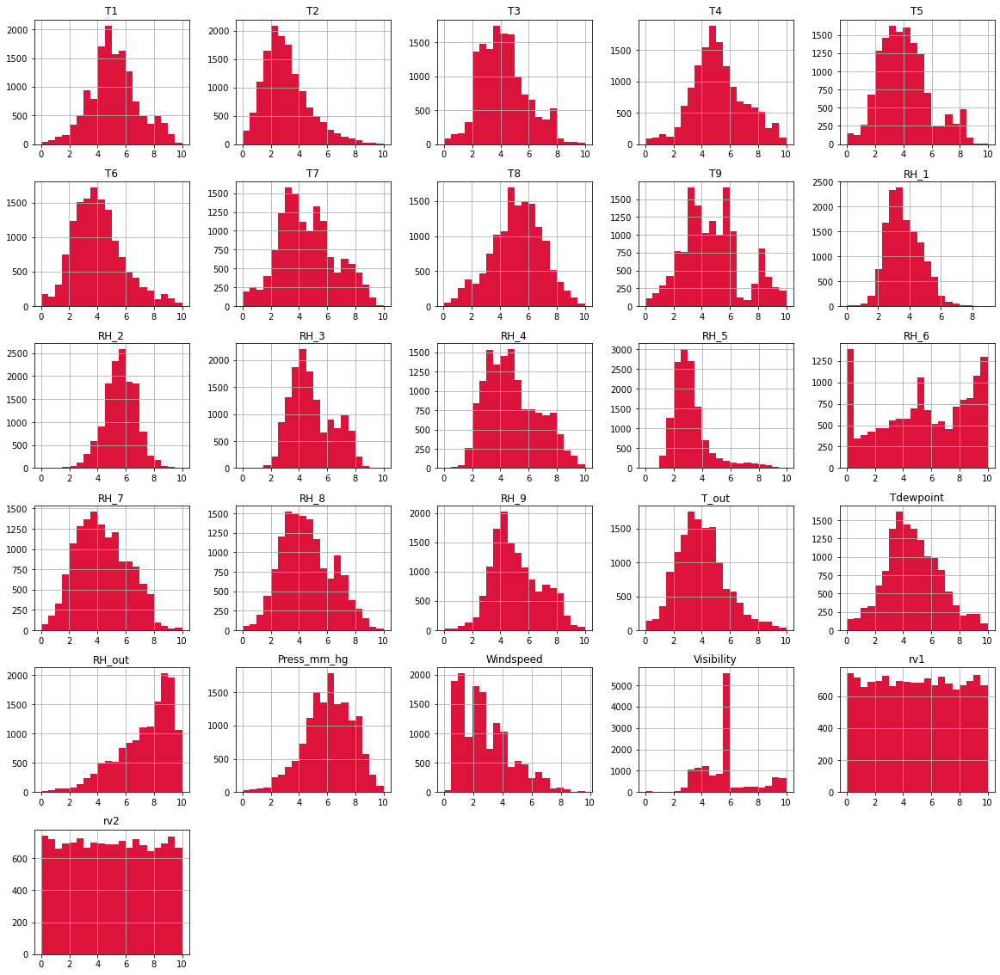

In [21]:
#histogram of all the features to understand the distribution
feature_vars.hist(bins = 20, figsize= (20,20), color = 'crimson')
plt.show()

The graphs above can classify the following features as:

1. Bimodal      - T3, T5, RH_3, RH_8
2. Multimodal   - T7, T9, RH_4, RH_6, Windspeed
3. Uniform      - rv1, rv2
4. Normal       - T1, T4, T8, RH_7, RH_9, Tdewpoint
5. Exponential  - RH_5, Visibility, lights
6. Right skewed - T2, T6, RH_1, T_out
7. Left skewed  - RH_2, RH_out, Press_mm_hg

### Correlation amongst features:

In [22]:
feature_vars.corr()

,T1,T2,T3,T4,T5,T6,T7,T8,T9,RH_1,...,RH_8,RH_9,T_out,Tdewpoint,RH_out,Press_mm_hg,Windspeed,Visibility,rv1,rv2
T1,1.000000,0.836141,0.891783,0.875943,0.885030,0.653325,0.835441,0.822289,0.842161,0.171053,...,-0.005052,0.070845,0.680609,0.571092,-0.342757,-0.151886,-0.091763,-0.079179,-0.007881,-0.007881
T2,0.836141,1.000000,0.734407,0.759193,0.719900,0.800810,0.658742,0.573880,0.671803,0.280373,...,0.074252,0.161415,0.791628,0.584353,-0.503680,-0.135573,0.050085,-0.074495,-0.017270,-0.017270
T3,0.891783,0.734407,1.000000,0.852258,0.887471,0.687806,0.846774,0.792393,0.900608,0.259834,...,0.045535,0.135354,0.699996,0.646698,-0.281477,-0.194305,-0.105584,-0.104235,-0.008219,-0.008219
T4,0.875943,0.759193,0.852258,1.000000,0.871652,0.650816,0.877983,0.796774,0.889959,0.110231,...,-0.097167,-0.028839,0.661549,0.518887,-0.387293,-0.077123,-0.193189,-0.103676,-0.003645,-0.003645
T5,0.885030,0.719900,0.887471,0.871652,1.000000,0.627673,0.868783,0.822831,0.909480,0.214048,...,0.019231,0.072643,0.649605,0.588889,-0.270725,-0.174587,-0.149036,-0.084954,-0.006517,-0.006517
T6,0.653325,0.800810,0.687806,0.650816,0.627673,1.000000,0.617251,0.480673,0.666263,0.326443,...,0.081255,0.190141,0.974913,0.767265,-0.566853,-0.146490,0.161654,-0.080203,-0.017740,-0.017740
T7,0.835441,0.658742,0.846774,0.877983,0.868783,0.617251,1.000000,0.882206,0.944758,0.027051,...,-0.209846,-0.080256,0.629969,0.467145,-0.409992,-0.106220,-0.190458,-0.111365,-0.004737,-0.004737
T8,0.822289,0.573880,0.792393,0.796774,0.822831,0.480673,0.882206,1.000000,0.868856,-0.030641,...,-0.212036,-0.163070,0.500982,0.389052,-0.301795,-0.167793,-0.223887,-0.061780,-0.002204,-0.002204
T9,0.842161,0.671803,0.900608,0.889959,0.909480,0.666263,0.944758,0.868856,1.000000,0.119109,...,-0.114004,-0.012312,0.667710,0.581327,-0.318682,-0.163657,-0.183174,-0.104790,-0.003333,-0.003333
RH_1,0.171053,0.280373,0.259834,0.110231,0.214048,0.326443,0.027051,-0.030641,0.119109,1.000000,...,0.735923,0.766468,0.350829,0.642646,0.266017,-0.291204,0.207387,-0.022749,-0.004601,-0.004601


<AxesSubplot:>

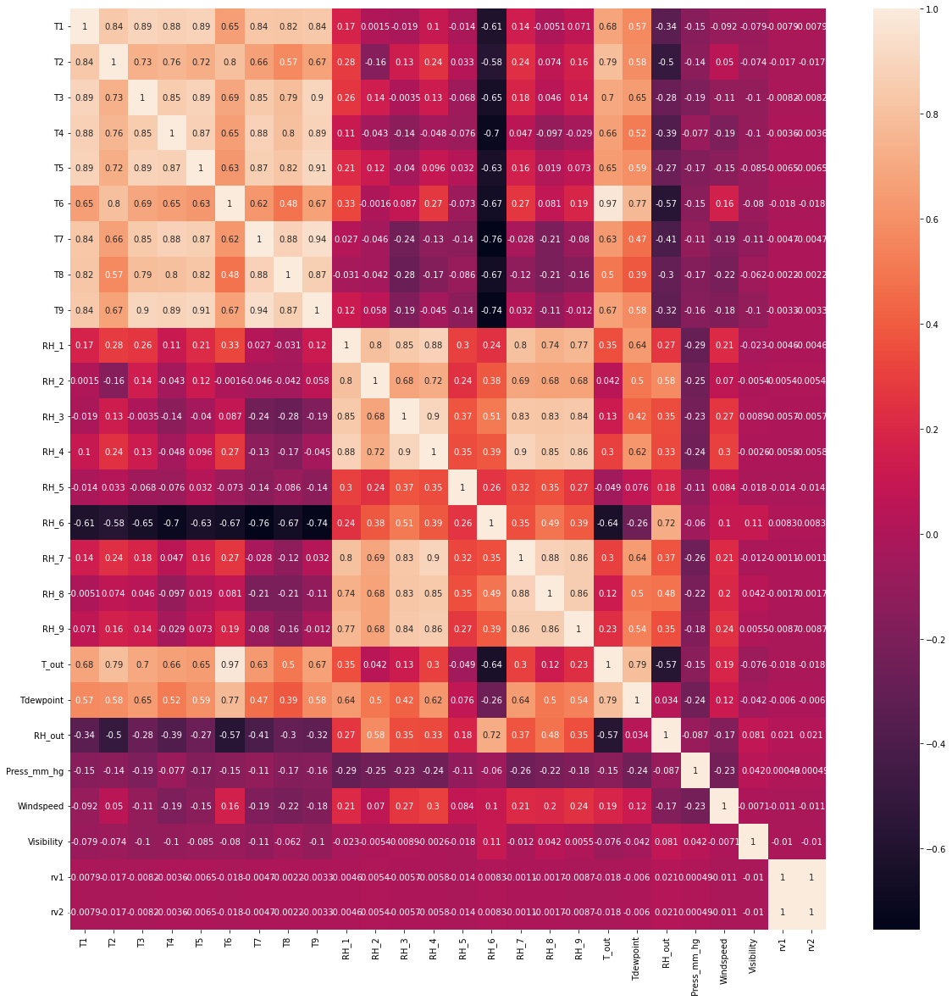

In [23]:
#annot is used to make sure the corr numbers are see on the figure, if given as false, the number dont appear
plt.figure(figsize = (20,20))
sns.heatmap(feature_vars.corr(), annot = True)

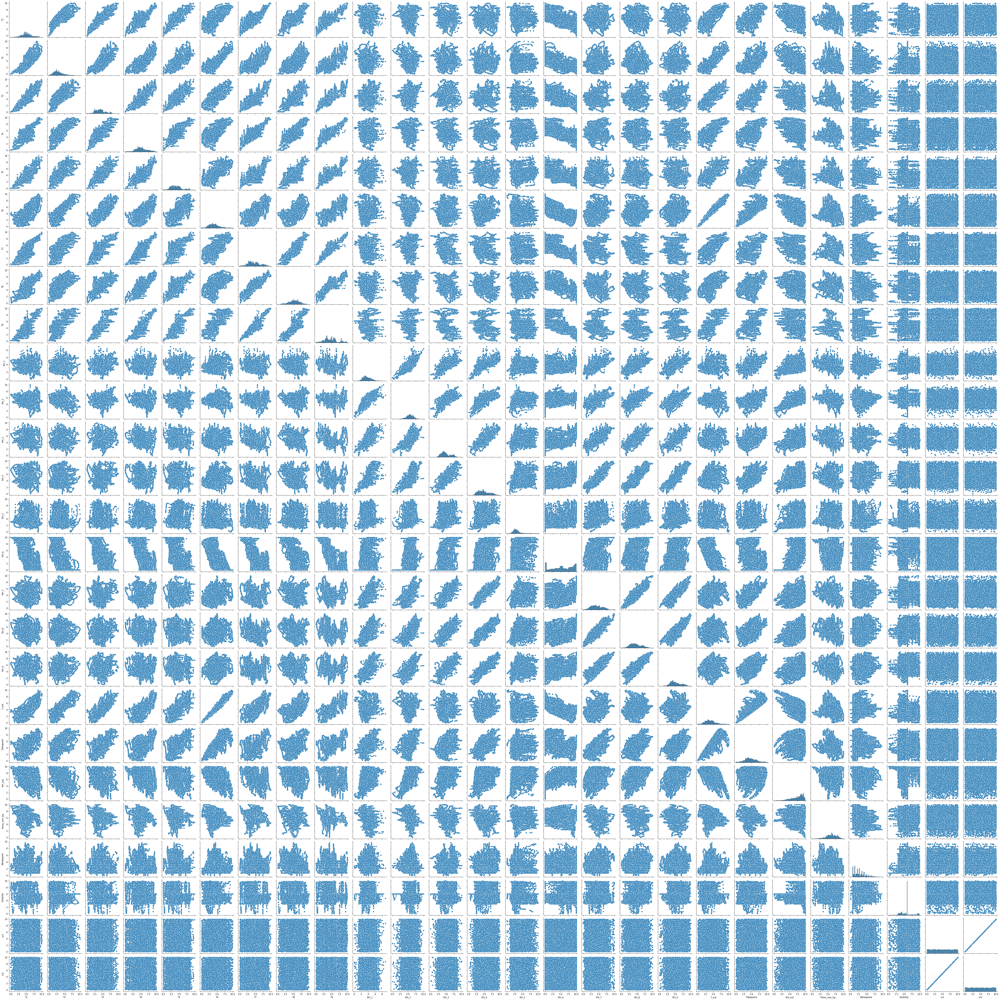

In [26]:
sns.pairplot(feature_vars)

Observations:

1. All temperature features which are a part of the house are positively correlated to each other which makes sense since they are a part of the same house.
2. The humidity outside the building on the north side (RH_6) are related the temperatures in and around the house in a negative sense.
3. All humidity features which are a part of the house are positively correlated to each other which makes sense since they are a part of the same house.
4. The two non-dimensional random variables are fully positively correlated.

[Text(0.5, 1.0, 'T7 vs T9')]

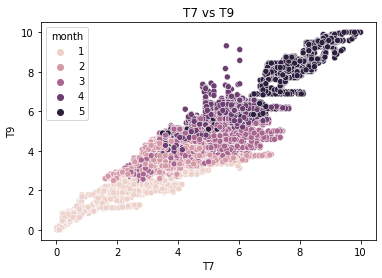

In [24]:
sns.scatterplot(x = "T7" , y = "T9", data = train , hue = 'month').set(title = 'T7 vs T9')

In [4]:
fig = px.scatter_3d(energy, x='T7', y='T9', z='month',color='month')
fig.show()

ValueError: Value of 'z' is not the name of a column in 'data_frame'. Expected one of ['date', 'Appliances', 'lights', 'T1', 'RH_1', 'T2', 'RH_2', 'T3', 'RH_3', 'T4', 'RH_4', 'T5', 'RH_5', 'T6', 'RH_6', 'T7', 'RH_7', 'T8', 'RH_8', 'T9', 'RH_9', 'T_out', 'Press_mm_hg', 'RH_out', 'Windspeed', 'Visibility', 'Tdewpoint', 'rv1', 'rv2'] but received: month

The above scatter plots signifies the relationship between the temperature in the ironing room and the temperature in the parents room.
The relation as we can observe also signifies the month. This aspect makes it clear that as the months change, the temperature also rises.
The relation depicted is a linear positive relation, hence, one factor increases as the other increases.

[Text(0.5, 1.0, 'RH_6 vs T7')]

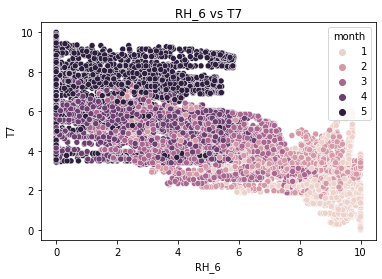

In [27]:
sns.scatterplot(x = "RH_6" , y = "T7", data = train, hue='month').set(title = 'RH_6 vs T7')

In [42]:
fig = px.scatter_3d(energy, x='RH_6', y='T7', z='month',color='month')
fig.show()

The above scatter plots signifies the relationship between the humidity in the bathroom and the temperature in the ironing room.
The relation as we can observe also signifies the month. This aspect makes it clear that as the months change, the temperature also decreases.
The relation depicted is a non-linear negative relation, hence, one factor decreases as the other decreases.

[Text(0.5, 1.0, 'T_out vs T6')]

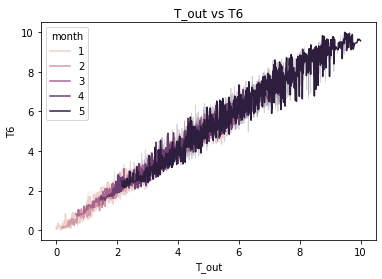

In [29]:
sns.lineplot(x = "T_out" , y = "T6", data = train, hue = 'month').set(title = 'T_out vs T6')

In [43]:
fig = px.line_3d(energy, x="T_out", y="T6",z='month',color='month')
fig.show()

The above line plots signifies the relationship between the temperature outside and the temperature outside the buliding(north side).
The relation as we can observe also signifies the month. This aspect makes it clear that as the months change, the temperature also rises.
The relation depicted is a linear positive relation, hence, one factor increases as the other increases.

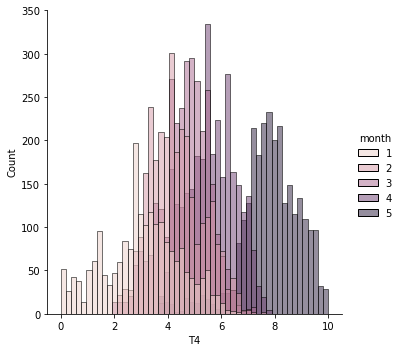

In [31]:
sns.displot(data = train , x ="T4" , hue = 'month')

From the above dist plot we can observe that most values in our dataset have a temperature (scaled) in the office room of 5.6 celsius.
The month feature shows us that month 1 has low temperatures whereas the month 4 has higher temperature readings.

<AxesSubplot:>

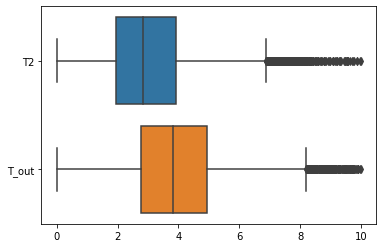

In [32]:
sns.boxplot(data = feature_vars[['T2','T_out']] , orient='h')

Analysis of box plot:

* T2: [Right skewed]
  1. Maximum - 6.8
  2. Minimum - 0
  3. Median - 2.6
  4. First Quartile - 2
  5. Third Quartile - 4
  6. Inter Quartile Range - 2

* T_out: [Right skewed]
  1. Maximum - 8.2
  2. Minimum - 0
  3. Median - 3.8
  4. First Quartile - 2.8
  5. Third Quartile - 4.8
  6. Inter Quartile Range - 2


<AxesSubplot:>

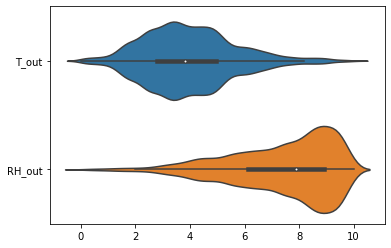

In [33]:
sns.violinplot(data = feature_vars[['T_out','RH_out']] , orient='h')

Analysis of violin plot:

* RH_out: [Left skewed]
  1. Maximum - 10
  2. Minimum - 2
  3. Median - 7.8
  4. First Quartile - 6.2
  5. Third Quartile - 8.8
  6. Inter Quartile Range - 2.6

* T_out: [Right skewed]
  1. Maximum - 8.2
  2. Minimum - 0
  3. Median - 3.8
  4. First Quartile - 2.8
  5. Third Quartile - 4.8
  6. Inter Quartile Range - 2

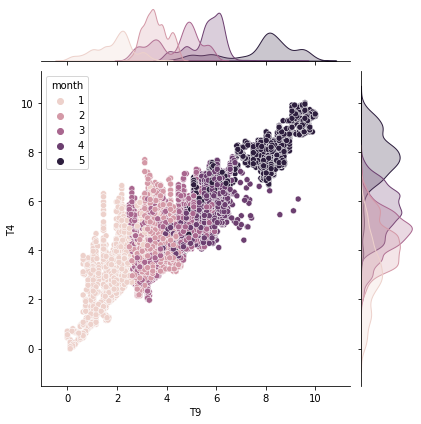

In [34]:
sns.jointplot(data = train, x="T9", y="T4", hue='month')

The joint plot above helps in interpreting two different plots at the same time, namely, scatter plot and histogram.
The above is a relation between the temperatures in parents room and the office room.
As we can observe from the scatter plot, there is a linear positive relation.
Using the density curves, we can interpret the same things as we interpreted from the histograms of T4 and T9 shown previously.

Text(0.5, 1.0, 'Distribution of appliances power consumption across the dataset')

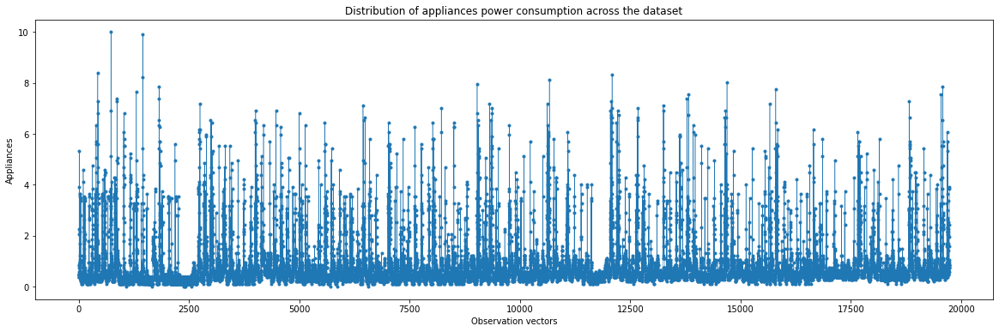

In [35]:
y = energy['Appliances']
fig, ax = plt.subplots(figsize=(20, 6))
ax.plot(y,marker='.', linestyle='-', linewidth=0.5, label='Monthly')
ax.set_xlabel('Observation vectors')
ax.set_ylabel('Appliances')
ax.set_title('Distribution of appliances power consumption across the dataset')

The subplot shows us the distribution of power consumption of appliances across the dataset. The maximum value of power are achieved at approximately the 750th observation. 

In [36]:
fig = px.pie(energy,values='Appliances', names='month')
fig.show()

The pie chart shows percentage of power consumption of the appliances per month.

## SAMPLING

In [37]:
#random sampling

# function that creates random sample 
random_sample = energy.sample(n=1000)
random_sample

,date,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,...,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2,Date,Time,hour,month
15159,2016-04-25 23:30:00,0.467290,2.857143,5.184794,2.993303,2.253453,5.510357,3.738784,3.642312,5.666667,...,9.013158,2.857143,7.153846,4.411765,2.379502,2.379502,2016-04-25,23:30:00,23,4
13522,2016-04-14 14:40:00,0.654206,0.000000,5.807814,3.964774,4.797674,5.088574,4.901961,4.684530,7.324324,...,4.605263,2.142857,6.000000,6.576169,5.555204,5.555204,2016-04-14,14:40:00,14,4
7392,2016-03-03 01:00:00,0.280374,0.000000,4.857445,2.883222,2.592682,4.695848,2.982719,4.548995,4.414414,...,8.552632,3.571429,6.000000,3.303167,6.377588,6.377588,2016-03-03,01:00:00,1,3
7364,2016-03-02 20:20:00,0.934579,2.857143,5.315030,3.716173,3.319603,5.258225,3.267974,5.388690,5.699700,...,8.903509,4.523810,6.769231,3.348416,4.860347,4.860347,2016-03-02,20:20:00,20,3
16511,2016-05-05 08:50:00,2.149533,0.000000,5.807814,1.939960,6.224861,2.343237,5.142905,2.642156,6.666667,...,4.100877,2.023810,6.000000,3.853695,0.512549,0.512549,2016-05-05,08:50:00,8,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2120,2016-01-26 10:20:00,0.186916,0.000000,3.389652,4.982112,2.253453,6.871309,2.741775,7.306434,3.864865,...,9.078947,3.809524,9.384615,6.817496,0.100255,0.100255,2016-01-26,10:20:00,10,1
16421,2016-05-04 17:50:00,1.028037,0.000000,7.296727,1.240253,5.250787,2.323554,5.059821,2.679545,7.468468,...,1.337719,2.261905,6.000000,3.144796,2.708714,2.708714,2016-05-04,17:50:00,17,5
8950,2016-03-13 20:40:00,1.028037,0.000000,5.385428,2.305293,2.343106,4.781142,2.932868,3.516124,4.798799,...,6.798246,2.857143,3.333333,3.589744,4.413304,4.413304,2016-03-13,20:40:00,20,3
546,2016-01-15 12:00:00,0.467290,1.428571,4.329461,3.130905,3.045796,4.973287,2.650382,5.109830,4.529530,...,8.421053,6.428571,3.076923,3.800905,9.960342,9.960342,2016-01-15,12:00:00,12,1


In [38]:
#systematic sampling

def systematic_sampling(df, step):
    indexes = np.arange(0, len(df), step=step)
    systematic_sample = df.iloc[indexes]
    return systematic_sample

systematic_sample = systematic_sampling(energy, 1000)
systematic_sample

,date,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,...,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2,Date,Time,hour,month
0,2016-01-11 17:00:00,0.467290,4.285714,3.273495,5.661866,2.253453,6.840379,2.151878,7.460664,3.513514,...,8.947368,5.000000,9.538462,5.384615,2.654489,2.654489,2016-01-11,17:00:00,17,1
1000,2016-01-18 15:40:00,0.186916,0.000000,2.675114,3.956518,1.526533,5.887150,1.994018,5.525783,3.324324,...,5.921053,1.666667,5.435897,0.482655,5.307957,5.307957,2016-01-18,15:40:00,15,1
2000,2016-01-25 14:20:00,0.186916,0.000000,3.840197,4.506926,2.471529,6.362358,2.567298,7.306434,2.792793,...,4.166667,3.571429,6.000000,4.871795,8.718519,8.718519,2016-01-25,14:20:00,14,1
3000,2016-02-01 13:00:00,0.654206,1.428571,6.099965,5.164664,4.385752,6.410160,5.034895,8.551176,4.054054,...,6.842105,7.142857,6.000000,6.244344,8.023842,8.023842,2016-02-01,13:00:00,13,2
4000,2016-02-08 11:40:00,2.710280,0.000000,4.329461,4.789469,2.956142,6.261130,4.012961,7.787817,5.315315,...,7.543860,6.428571,7.179487,5.022624,1.876950,1.876950,2016-02-08,11:40:00,11,2
5000,2016-02-15 10:20:00,6.822430,2.857143,2.861668,4.158334,1.570148,5.267598,2.234962,4.873033,3.153153,...,6.666667,4.285714,6.000000,2.503771,0.353993,0.353993,2016-02-15,10:20:00,10,2
6000,2016-02-22 09:00:00,0.373832,0.000000,4.551214,4.800477,2.616913,6.831943,3.763709,6.636548,4.864865,...,8.947368,5.000000,9.692308,6.425339,7.701104,7.701104,2016-02-22,09:00:00,9,2
7000,2016-02-29 07:40:00,0.280374,1.428571,2.333685,1.952344,0.574267,4.359359,1.994018,3.394610,2.792793,...,8.859649,2.857143,3.333333,2.322775,6.986936,6.986936,2016-02-29,07:40:00,7,2
8000,2016-03-07 06:20:00,0.280374,0.000000,2.439282,2.727273,0.574267,5.352892,1.994018,4.517838,3.085586,...,9.956140,0.952381,4.051282,3.031674,1.281813,1.281813,2016-03-07,06:20:00,6,3
9000,2016-03-14 05:00:00,0.373832,0.000000,3.801478,2.219980,0.574267,5.465367,2.650382,3.890014,3.963964,...,8.815789,2.142857,9.384615,2.352941,9.404368,9.404368,2016-03-14,05:00:00,5,3


In [39]:
#stratified sampling

stratified_sample, _ = train_test_split(energy, test_size=0.9, stratify=energy[['month']])
print (stratified_sample)

                     date  Appliances    lights        T1      RH_1        T2  \
13508 2016-04-14 12:20:00    0.654206  1.428571  5.279831  4.176681  4.841289   
8914  2016-03-13 14:40:00    0.560748  1.428571  5.184794  2.120906  3.198449   
17162 2016-05-09 21:20:00    0.560748  2.857143  9.197466  4.284011  6.389629   
9241  2016-03-15 21:10:00    1.121495  0.000000  4.973601  4.018897  2.253453   
5893  2016-02-21 15:10:00    0.934579  4.285714  4.934882  5.038987  3.481948   
...                   ...         ...       ...       ...       ...       ...   
14484 2016-04-21 07:00:00    0.186916  0.000000  5.008800  2.753876  1.955416   
14999 2016-04-24 20:50:00    0.841121  1.428571  5.501584  2.332814  2.318876   
13775 2016-04-16 08:50:00    0.841121  0.000000  5.501584  4.221631  3.246911   
4159  2016-02-09 14:10:00    1.121495  0.000000  5.385428  4.633520  3.271141   
6657  2016-02-26 22:30:00    0.373832  0.000000  4.751848  2.663058  2.859220   

           RH_2        T3  